# Spring 2022 MSBA 605 Final Project

### Group 1.1: T7

Louisville is an awesome city for many reasons: it offers so many food and entertainment options, is a short drive to visit many other cities, and is known for its reasonable cost of living.

However, lower cost of living can also lead to lower wages. 

To understand basic compensation characteristics of the local workforce, we will use pubically available data to explore the demographics of the Kentucky workforce, compare these demographics to the National level, then go into greater detail by exploring regional differences in Kentucky.


In [1]:
# Description abt the problem:
#expain abt each section.

## SECTION 1 

To get started, read in the Kentucky workforce data set called 2021_StatewideOccupationalEmploymentAndWages.xlsx (this data was pulled from KYStats (https://kystats.ky.gov/KYLMI/OEWSWage).

In [2]:
## imorting packages and starting the process on......
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns



In [3]:
# knowing the colums will give a more clearer picture of the data set, so column headings printed
df=pd.read_excel("2021_StatewideOccupationalEmploymentAndWages.xlsx")# reading the given xlsx file
print(df.columns)
df.head()

Index(['SOC Code', 'Standard Occupational Classification (SOC) Title',
       'Estimated Employment', 'Entry Hourly', 'Entry Annual', 'Mean Hourly',
       'Mean Annual', '25th Percentile Hourly', '25th Percentile Annual',
       'Median Hourly', 'Median Annual ', '75th Percentile Hourly',
       '75th Percentile Annual', 'Experienced Hourly', 'Experienced Annual',
       'Unnamed: 15'],
      dtype='object')


,SOC Code,Standard Occupational Classification (SOC) Title,Estimated Employment,Entry Hourly,Entry Annual,Mean Hourly,Mean Annual,25th Percentile Hourly,25th Percentile Annual,Median Hourly,Median Annual,75th Percentile Hourly,75th Percentile Annual,Experienced Hourly,Experienced Annual,Unnamed: 15
0,00-0000,Total All Occupations,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN
1,11-0000,Management Occupations,85990.0,19.96,41515.0,46.89,97513.0,27.84,57909.0,40.16,83537.0,57.93,120501.0,82.09,170744.0,NaN
2,11-1011,Chief Executives,2710.0,31.15,64786.0,79.10,164515.0,46.90,97554.0,65.99,137259.0,NaN,NaN,NaN,NaN,NaN
3,11-1021,General and Operations Managers,32010.0,17.28,35953.0,45.05,93701.0,24.49,50961.0,36.08,75062.0,56.32,117154.0,85.74,178350.0,NaN
4,11-2011,Advertising and Promotions Managers,110.0,21.53,44772.0,50.27,104572.0,24.51,50982.0,38.72,80543.0,66.35,138007.0,99.04,206000.0,NaN


In the Labor field, there is a standard method of classifying occupations called 'SOC codes'. These codes are structured so that the first two digits reflect the type of occupation and the last 4 digits reflect more specific details about the occupation. Numeric SOC codes have corresponding string titles. For our purposes, the string titles will be helpful for visualization and grouping purposes. For that reason, set the index to the 'Standard Occupational Classification (SOC) Title'

In [4]:
df = df.set_index('Standard Occupational Classification (SOC) Title')# setting the index to the 'Standard Occupational Classification (SOC) Title'
df.head(5)
# the querstion asks to set the index to 'Standard Occupational Classification (SOC) Title'

,SOC Code,Estimated Employment,Entry Hourly,Entry Annual,Mean Hourly,Mean Annual,25th Percentile Hourly,25th Percentile Annual,Median Hourly,Median Annual,75th Percentile Hourly,75th Percentile Annual,Experienced Hourly,Experienced Annual,Unnamed: 15
Standard Occupational Classification (SOC) Title,,,,,,,,,,,,,,,
Total All Occupations,00-0000,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN
Management Occupations,11-0000,85990.0,19.96,41515.0,46.89,97513.0,27.84,57909.0,40.16,83537.0,57.93,120501.0,82.09,170744.0,NaN
Chief Executives,11-1011,2710.0,31.15,64786.0,79.10,164515.0,46.90,97554.0,65.99,137259.0,NaN,NaN,NaN,NaN,NaN
General and Operations Managers,11-1021,32010.0,17.28,35953.0,45.05,93701.0,24.49,50961.0,36.08,75062.0,56.32,117154.0,85.74,178350.0,NaN
Advertising and Promotions Managers,11-2011,110.0,21.53,44772.0,50.27,104572.0,24.51,50982.0,38.72,80543.0,66.35,138007.0,99.04,206000.0,NaN


Within the data set are several rows that belong to broad categories of occupations. These SOC codes end with -0000 as the final 5 characters. Throughout this final, there will be times where it will be appropriate to use the broad categories and times where we will want the specific occupations, but generally not both. To move forward, split the data set into two data set, one with the broad categories, one with all but the broad categories, using the SOC codes variable.

In [5]:
df['SOC Code'].str[2:] # just having a look at the would be data set once split

Standard Occupational Classification (SOC) Title
Total All Occupations                               -0000
Management Occupations                              -0000
Chief Executives                                    -1011
General and Operations Managers                     -1021
Advertising and Promotions Managers                 -2011
                                                    ...  
Gas Compressor and Gas Pumping Station Operators    -7071
Pump Operators, Except Wellhead Pumpers             -7072
Wellhead Pumpers                                    -7073
Refuse and Recyclable Material Collectors           -7081
Tank Car, Truck, and Ship Loaders                   -7121
Name: SOC Code, Length: 739, dtype: object

In [10]:
df_broad = df[df['SOC Code'].str[2:]=='-0000']
df_broad # splitting SOC as broad

,SOC Code,Estimated Employment,Entry Hourly,Entry Annual,Mean Hourly,Mean Annual,25th Percentile Hourly,25th Percentile Annual,Median Hourly,Median Annual,75th Percentile Hourly,75th Percentile Annual,Experienced Hourly,Experienced Annual,Unnamed: 15
Standard Occupational Classification (SOC) Title,,,,,,,,,,,,,,,
Total All Occupations,00-0000,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN
Management Occupations,11-0000,85990.0,19.96,41515.0,46.89,97513.0,27.84,57909.0,40.16,83537.0,57.93,120501.0,82.09,170744.0,NaN
Business and Financial Operations Occupations,13-0000,79140.0,16.76,34851.0,32.59,67770.0,22.07,45905.0,29.49,61338.0,39.42,81999.0,51.25,106605.0,NaN
Computer and Mathematical Occupations,15-0000,35750.0,19.16,39853.0,36.94,76858.0,25.52,53075.0,34.76,72308.0,46.48,96683.0,58.54,121782.0,NaN
Architecture and Engineering Occupations,17-0000,26150.0,19.39,40322.0,36.24,75389.0,25.19,52402.0,34.46,71655.0,45.25,94122.0,56.72,117976.0,NaN
"Life, Physical, and Social Science Occupations",19-0000,12910.0,16.83,35016.0,30.66,63778.0,21.43,44566.0,28.36,58993.0,37.32,77634.0,48.13,100111.0,NaN
Community and Social Service Occupations,21-0000,29570.0,12.71,26446.0,21.79,45321.0,15.75,32762.0,19.98,41556.0,26.32,54759.0,34.03,70767.0,NaN
Legal Occupations,23-0000,9850.0,16.65,34639.0,41.37,86051.0,22.03,45811.0,31.46,65441.0,51.44,106998.0,76.38,158859.0,NaN
Educational Instruction and Library Occupations,25-0000,94120.0,11.79,24528.0,24.60,51168.0,17.24,35863.0,24.14,50219.0,29.95,62289.0,36.14,75175.0,NaN


In [11]:
df_NonBroad = df[df['SOC Code'].str[2:] != '-0000']
df_NonBroad ## splitting SOC as NonBroad

,SOC Code,Estimated Employment,Entry Hourly,Entry Annual,Mean Hourly,Mean Annual,25th Percentile Hourly,25th Percentile Annual,Median Hourly,Median Annual,75th Percentile Hourly,75th Percentile Annual,Experienced Hourly,Experienced Annual,Unnamed: 15
Standard Occupational Classification (SOC) Title,,,,,,,,,,,,,,,
Chief Executives,11-1011,2710.0,31.15,64786.0,79.10,164515.0,46.90,97554.0,65.99,137259.0,NaN,NaN,NaN,NaN,NaN
General and Operations Managers,11-1021,32010.0,17.28,35953.0,45.05,93701.0,24.49,50961.0,36.08,75062.0,56.32,117154.0,85.74,178350.0,NaN
Advertising and Promotions Managers,11-2011,110.0,21.53,44772.0,50.27,104572.0,24.51,50982.0,38.72,80543.0,66.35,138007.0,99.04,206000.0,NaN
Marketing Managers,11-2021,1740.0,26.40,54906.0,58.56,121796.0,35.59,74020.0,50.81,105685.0,76.54,159205.0,99.74,207456.0,NaN
Sales Managers,11-2022,3020.0,26.17,54430.0,57.15,118863.0,34.46,71674.0,51.81,107778.0,72.35,150497.0,95.91,199487.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Gas Compressor and Gas Pumping Station Operators,53-7071,NaN,22.34,46462.0,31.04,64567.0,24.91,51815.0,30.98,64434.0,37.48,77948.0,41.28,85874.0,NaN
"Pump Operators, Except Wellhead Pumpers",53-7072,NaN,13.93,28964.0,22.82,47461.0,17.02,35418.0,21.81,45361.0,26.94,56014.0,33.35,69374.0,NaN
Wellhead Pumpers,53-7073,100.0,13.41,27904.0,24.99,51979.0,16.83,34996.0,28.10,58443.0,31.39,65309.0,33.84,70404.0,NaN


### FOR THE REMAINDER OF THIS SECTION USE BROAD OCCUPATION CATEGORIES

Create a barplot to visualize the Entry Annual Salary by occupation in descending order

<AxesSubplot:xlabel='Standard Occupational Classification (SOC) Title'>

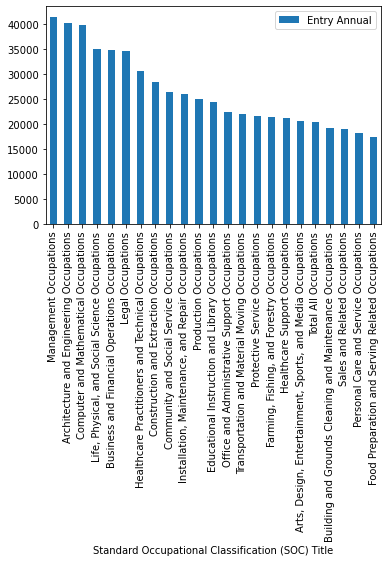

In [12]:
df_broad.sort_values(by='Entry Annual', ascending=False).plot(y ='Entry Annual', kind = 'bar')


Create a barplot to visualize the Experienced Annual Salary by occupation in descending order

<AxesSubplot:xlabel='Standard Occupational Classification (SOC) Title'>

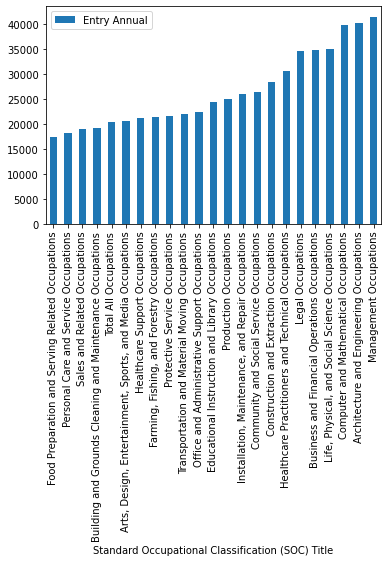

In [13]:
df_broad.sort_values(by='Entry Annual', ascending=True).plot(y ='Entry Annual', kind = 'bar')

Create a new variable called 'Salary Growth Potential' that calculates the potential salary growth as a percentage of Entry Annual Salary ((Experienced-Entry)/Entry). Create a barplot to display the salary growth potential in descending order.

In [14]:
#Salary_Growth_Potential

df_broad['salary_growth_potential']= (df_broad['Experienced Annual']-(df_broad['Entry Annual'])) / (df_broad['Entry Annual'])*100
df_broad

<ipython-input-14-e164ee9a0bb8>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_broad['salary_growth_potential']= (df_broad['Experienced Annual']-(df_broad['Entry Annual'])) / (df_broad['Entry Annual'])*100


,SOC Code,Estimated Employment,Entry Hourly,Entry Annual,Mean Hourly,Mean Annual,25th Percentile Hourly,25th Percentile Annual,Median Hourly,Median Annual,75th Percentile Hourly,75th Percentile Annual,Experienced Hourly,Experienced Annual,Unnamed: 15,salary_growth_potential
Standard Occupational Classification (SOC) Title,,,,,,,,,,,,,,,,
Total All Occupations,00-0000,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN,300.000000
Management Occupations,11-0000,85990.0,19.96,41515.0,46.89,97513.0,27.84,57909.0,40.16,83537.0,57.93,120501.0,82.09,170744.0,NaN,311.282669
Business and Financial Operations Occupations,13-0000,79140.0,16.76,34851.0,32.59,67770.0,22.07,45905.0,29.49,61338.0,39.42,81999.0,51.25,106605.0,NaN,205.887923
Computer and Mathematical Occupations,15-0000,35750.0,19.16,39853.0,36.94,76858.0,25.52,53075.0,34.76,72308.0,46.48,96683.0,58.54,121782.0,NaN,205.577999
Architecture and Engineering Occupations,17-0000,26150.0,19.39,40322.0,36.24,75389.0,25.19,52402.0,34.46,71655.0,45.25,94122.0,56.72,117976.0,NaN,192.584693
"Life, Physical, and Social Science Occupations",19-0000,12910.0,16.83,35016.0,30.66,63778.0,21.43,44566.0,28.36,58993.0,37.32,77634.0,48.13,100111.0,NaN,185.900731
Community and Social Service Occupations,21-0000,29570.0,12.71,26446.0,21.79,45321.0,15.75,32762.0,19.98,41556.0,26.32,54759.0,34.03,70767.0,NaN,167.590562
Legal Occupations,23-0000,9850.0,16.65,34639.0,41.37,86051.0,22.03,45811.0,31.46,65441.0,51.44,106998.0,76.38,158859.0,NaN,358.613124
Educational Instruction and Library Occupations,25-0000,94120.0,11.79,24528.0,24.60,51168.0,17.24,35863.0,24.14,50219.0,29.95,62289.0,36.14,75175.0,NaN,206.486464


<AxesSubplot:xlabel='Standard Occupational Classification (SOC) Title'>

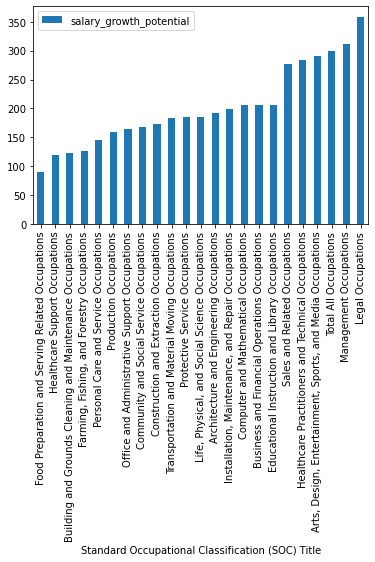

In [15]:
df_broad.sort_values(by='salary_growth_potential', ascending=True).plot(y ='salary_growth_potential', kind = 'bar')

## SECTION 2 

### FOR THE SECTION TASK USE DETAILED OCCUPATION CATEGORIES

#### Repeat the following using only Food Preparation and Serving Related Occupations (SOC codes begin with 35)
Create a barplot to visualize the highest Entry Annual Salary
Create a barplot to visualize the highest Experienced Annual Salary
Create a new variable called 'Salary Growth Potential' that calculates the potential salary growth as a percentage of Entry Annual Salary ((Experienced-Entry)/Entry)

In [16]:
df_food = df[df['SOC Code'].str[:2]=='35']

<ipython-input-17-98e9e55c0544>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_food.sort_values(by=['Entry Annual'], inplace=True, ascending=False)


<AxesSubplot:xlabel='Standard Occupational Classification (SOC) Title'>

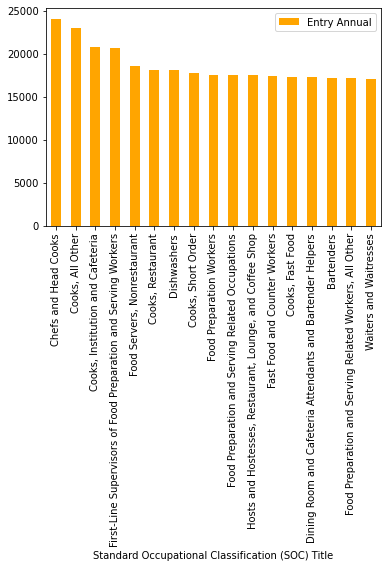

In [17]:
df_food.sort_values(by=['Entry Annual'], inplace=True, ascending=False)
df_food.plot.bar(y='Entry Annual', color='orange')

<ipython-input-18-82e2ee0fa135>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_food.sort_values(by=['Entry Annual'], inplace=True, ascending=False)


<AxesSubplot:xlabel='SOC Code'>

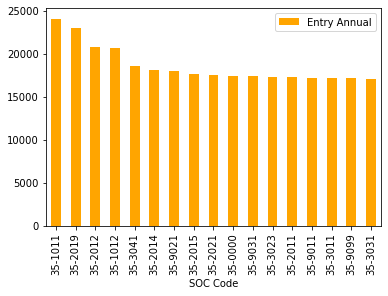

In [18]:
#df1, df2 = [x for _, x in k2df.groupby(df['SOC Code'] > '36')] '''SOC location in df'''

df_food = df.iloc[367:384]
df_food.sort_values(by=['Entry Annual'], inplace=True, ascending=False)
df_food.plot.bar(x='SOC Code',y='Entry Annual', color='orange')

# SOC Code 35-1011 has the highest entry salary- chefs and head cooks.

<ipython-input-19-56e327241d52>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_food.sort_values(by=['Experienced Annual'], inplace=True, ascending=False)


<AxesSubplot:xlabel='SOC Code'>

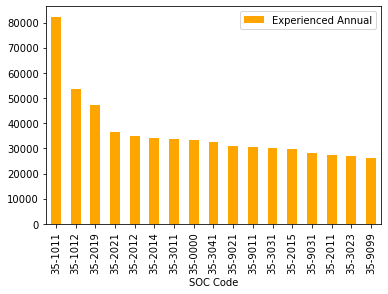

In [19]:
df_food.sort_values(by=['Experienced Annual'], inplace=True, ascending=False)
df_food.plot.bar(x='SOC Code',y='Experienced Annual', color='orange')

# Same as above- 35-1011 has the higest experienced salary

In [20]:
# percentage growth of occupations with respect to salries.
df_food['salary_growth_potential']= (df['Experienced Annual']-(df['Entry Annual'])) / (df['Entry Annual'])*100
df_food['salary_growth_potential']

<ipython-input-20-d749978f8f24>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_food['salary_growth_potential']= (df['Experienced Annual']-(df['Entry Annual'])) / (df['Entry Annual'])*100


Standard Occupational Classification (SOC) Title
Chefs and Head Cooks                                              241.527288
First-Line Supervisors of Food Preparation and Serving Workers    158.697751
Cooks, All Other                                                  105.816584
Food Preparation Workers                                          109.339876
Cooks, Institution and Cafeteria                                   68.668395
Cooks, Restaurant                                                  87.748363
Bartenders                                                         95.664303
Food Preparation and Serving Related Occupations                   89.808990
Food Servers, Nonrestaurant                                        75.965111
Dishwashers                                                        70.834255
Dining Room and Cafeteria Attendants and Bartender Helpers         77.488701
Waiters and Waitresses                                             77.107941
Cooks, Short Order         

## SECTION 3

### FOR THE NEXT SECTION USE DETAILED OCCUPATION CATEGORIES

In order to better understand how Kentucky compensation compares to National compensation, we will connect National data with Kentucky data.

Begin by reading in National Employment projections in the file called Employment Projections.xlsx (data was pulled from https://data.bls.gov/projections/occupationProj). Set index to 'Occupation Title'.

In [21]:
df_employment=pd.read_excel("Employment_Projections.xlsx")
print(df_employment.columns)

df_employment
pd.set_option('display.max_rows', None)

Index(['Occupation Title', 'Occupation Code', 'Employment 2020',
       'Employment 2030', 'Employment Change, 2020-2030',
       'Employment Percent Change, 2020-2030',
       'Occupational Openings, 2020-2030 Annual Average',
       'Median Annual Wage 2020', 'Typical Entry-Level Education',
       'Education Code', 'Work Experience in a Related Occupation',
       'Workex Code', 'Typical on-the-job Training', 'trCode'],
      dtype='object')


In [22]:
# Setting index to 'Occupation Title'
df_occu= df_employment.set_index('Occupation Title')
df_occu

,Occupation Code,Employment 2020,Employment 2030,"Employment Change, 2020-2030","Employment Percent Change, 2020-2030","Occupational Openings, 2020-2030 Annual Average",Median Annual Wage 2020,Typical Entry-Level Education,Education Code,Work Experience in a Related Occupation,Workex Code,Typical on-the-job Training,trCode
Occupation Title,,,,,,,,,,,,,
Accountants and auditors * Account Auditor* Accountant* Auditor* Auditor-In-Charge* CPA* Certified Public Accountant* Cost Accountant* Field Auditor* Financial Accountant* Financial Auditor* Fund Accountant* Internal Auditor* Payroll Auditor* Tax Accountant,13-2011,1392.2,1488.2,96.0,6.9,135.0,73560.0,Bachelor's degree,3,None,4,None,6
Actors * Actor Understudy* Actress* Dramatic Reader* Elocutionist* Monologist* Vaudeville Actor* Voice-Over Artist,27-2011,51.6,68.3,16.7,32.4,8.2,NaN,"Some college, no degree",6,None,4,Long-term on-the-job training,3
Actuaries * Actuarial Associate* Actuarial Mathematician* Health Actuary* Insurance Actuary* Pricing Actuary* Product Development Actuary,15-2011,27.7,34.5,6.8,24.5,2.4,111030.0,Bachelor's degree,3,None,4,Long-term on-the-job training,3
"Acupuncturists and healthcare diagnosing or treating practitioners, all other",29-1298,55.7,58.3,2.6,4.7,3.6,82420.0,Master's degree,2,None,4,None,6
Adhesive bonding machine operators and tenders * Glue Line Operator* Glue Machine Operator* Glue Reel Operator* Paper Gluing Operator,51-9191,12.5,12.6,0.1,0.9,1.5,36280.0,High school diploma or equivalent,7,None,4,Moderate-term on-the-job training,4
"Administrative law judges, adjudicators, and hearing officers * Appeals Examiner* Appeals Referee* Appellate Conferee* Hearing Examiner* Hearing Officer* Justice of The Peace* Traffic Court Referee",23-1021,15.5,15.6,0.1,0.8,0.7,97520.0,Doctoral or professional degree,1,5 years or more,1,Short-term on-the-job training,5
Administrative services and facilities managers,11-3010,322.0,350.5,28.6,8.9,29.2,98890.0,Bachelor's degree,3,Less than 5 years,2,None,6
"Adult basic education, adult secondary education, and English as a Second Language instructors * Adult Basic Studies Teacher* Adult Education Teacher* Adult Literacy Instructor* Adult Literacy Teacher* Adult Remedial Education Instructor* GED Instructor* General Educational Development (GED) Teacher* General Educational Development Teacher",25-3011,48.3,45.9,-2.4,-5.0,5.1,55350.0,Bachelor's degree,3,None,4,None,6
Advertising and promotions managers * Advertising Director* Advertising Executive* Advertising Manager* Classified Advertising Manager* Promotion Manager* Promotions Director* VP Advertising* VP Promotions,11-2011,23.2,25.6,2.4,10.3,2.5,133460.0,Bachelor's degree,3,Less than 5 years,2,None,6


Merge State data with National data keeping all field present in State data. Use SOC codes as your merge key. Make sure the index is still Occupation titles

In [23]:
pd.set_option('display.max_columns', 100)

In [24]:
# merge df_occu and df

df_state_National= pd.merge( df, df_occu, right_on='Occupation Code', left_on='SOC Code', how='left')
df_state_National.head(2)


,SOC Code,Estimated Employment,Entry Hourly,Entry Annual,Mean Hourly,Mean Annual,25th Percentile Hourly,25th Percentile Annual,Median Hourly,Median Annual,75th Percentile Hourly,75th Percentile Annual,Experienced Hourly,Experienced Annual,Unnamed: 15,Occupation Code,Employment 2020,Employment 2030,"Employment Change, 2020-2030","Employment Percent Change, 2020-2030","Occupational Openings, 2020-2030 Annual Average",Median Annual Wage 2020,Typical Entry-Level Education,Education Code,Work Experience in a Related Occupation,Workex Code,Typical on-the-job Training,trCode
0,00-0000,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,11-0000,85990.0,19.96,41515.0,46.89,97513.0,27.84,57909.0,40.16,83537.0,57.93,120501.0,82.09,170744.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


To start investigating whether the lower cost of living in Kentucky is reflected in compensation, create a new variable that calculates the what percent of the national median annual wage in 2020 the median annual Kentucky Salary is.

In [25]:
df_state_National['Median Annual Wage 2020']/df_state_National['Median Annual ']

0           NaN
1           NaN
2      1.354738
3      1.380858
4      1.657003
5      1.345224
6      1.227430
7      1.270640
8      1.348157
9      1.252766
10     1.370050
11     1.116803
12     1.242919
13     1.036195
14     1.192089
15     1.227582
16     1.065149
17          NaN
18     1.241806
19     1.361207
20     1.168397
21     1.161392
22     1.003690
23     1.261229
24     1.198966
25     0.982370
26     1.221836
27     1.265946
28     0.952079
29     1.191508
30     1.200207
31     1.844282
32     1.439994
33     1.202149
34          NaN
35          NaN
36     1.120125
37     0.988647
38     0.941121
39     1.178987
40     1.122212
41     1.112104
42     1.181767
43     1.093289
44     1.224079
45     1.261314
46     1.120573
47     1.189351
48     1.176404
49     1.218568
50     1.158115
51     1.162838
52     1.233361
53     1.219878
54     0.966233
55     1.085789
56     1.155350
57     1.358253
58     1.126675
59     1.078856
60     1.147122
61     1.754942
62     1

In [27]:
df_state_National['kty_national_m_per']= df_state_National['Median Annual Wage 2020']/df_state_National['Median Annual ']
df_state_National

,SOC Code,Estimated Employment,Entry Hourly,Entry Annual,Mean Hourly,Mean Annual,25th Percentile Hourly,25th Percentile Annual,Median Hourly,Median Annual,75th Percentile Hourly,75th Percentile Annual,Experienced Hourly,Experienced Annual,Unnamed: 15,Occupation Code,Employment 2020,Employment 2030,"Employment Change, 2020-2030","Employment Percent Change, 2020-2030","Occupational Openings, 2020-2030 Annual Average",Median Annual Wage 2020,Typical Entry-Level Education,Education Code,Work Experience in a Related Occupation,Workex Code,Typical on-the-job Training,trCode,kty_national_m_per
0,00-0000,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,11-0000,85990.0,19.96,41515.0,46.89,97513.0,27.84,57909.0,40.16,83537.0,57.93,120501.0,82.09,170744.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,11-1011,2710.0,31.15,64786.0,79.10,164515.0,46.90,97554.0,65.99,137259.0,NaN,NaN,NaN,NaN,NaN,11-1011,292.5,275.7,-16.8,-5.7,17.5,185950.0,Bachelor's degree,3.0,5 years or more,1.0,None,6.0,1.354738
3,11-1021,32010.0,17.28,35953.0,45.05,93701.0,24.49,50961.0,36.08,75062.0,56.32,117154.0,85.74,178350.0,NaN,11-1021,2411.9,2638.2,226.3,9.4,229.6,103650.0,Bachelor's degree,3.0,5 years or more,1.0,None,6.0,1.380858
4,11-2011,110.0,21.53,44772.0,50.27,104572.0,24.51,50982.0,38.72,80543.0,66.35,138007.0,99.04,206000.0,NaN,11-2011,23.2,25.6,2.4,10.3,2.5,133460.0,Bachelor's degree,3.0,Less than 5 years,2.0,None,6.0,1.657003
5,11-2021,1740.0,26.40,54906.0,58.56,121796.0,35.59,74020.0,50.81,105685.0,76.54,159205.0,99.74,207456.0,NaN,11-2021,293.7,323.1,29.4,10.0,28.5,142170.0,Bachelor's degree,3.0,5 years or more,1.0,None,6.0,1.345224
6,11-2022,3020.0,26.17,54430.0,57.15,118863.0,34.46,71674.0,51.81,107778.0,72.35,150497.0,95.91,199487.0,NaN,11-2022,397.9,425.8,27.9,7.0,37.0,132290.0,Bachelor's degree,3.0,Less than 5 years,2.0,None,6.0,1.227430
7,11-2030,570.0,24.05,50021.0,50.36,104755.0,30.24,62895.0,44.81,93205.0,64.35,133841.0,87.72,182476.0,NaN,11-2030,89.0,100.3,11.3,12.6,8.9,118430.0,Bachelor's degree,3.0,5 years or more,1.0,None,6.0,1.270640
8,11-3010,3090.0,20.11,41809.0,38.16,79370.0,26.04,54167.0,35.27,73352.0,46.48,96694.0,61.63,128187.0,NaN,11-3010,322.0,350.5,28.6,8.9,29.2,98890.0,Bachelor's degree,3.0,Less than 5 years,2.0,None,6.0,1.348157
9,11-3021,3060.0,34.00,70733.0,59.50,123748.0,43.11,89665.0,58.01,120653.0,73.32,152510.0,85.71,178269.0,NaN,11-3021,482.0,534.6,52.7,10.9,42.4,151150.0,Bachelor's degree,3.0,5 years or more,1.0,None,6.0,1.252766


Plot the 10 highest % and the 10 lowest %

In [28]:
df_state_National_N = df_state_National.sort_values('kty_national_m_per')
df_sate_National_low = df_state_National_N[:10]

In [29]:
df_state_National_N = df_state_National[~(df_state_National['kty_national_m_per'].isna())]
# df_state_National_N
df_state_National_N = df_state_National_N.sort_values('kty_national_m_per', ascending=False)
df_sate_National_top = df_state_National_N[0:10]

<AxesSubplot:xlabel='Occupation Code', ylabel='kty_national_m_per'>

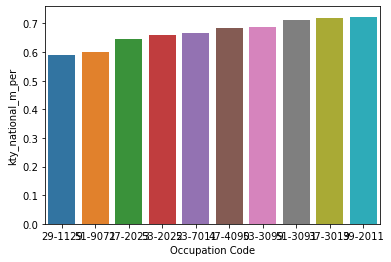

In [30]:
sns.barplot(data=df_sate_National_low, x="Occupation Code", y="kty_national_m_per")

<AxesSubplot:xlabel='Occupation Code', ylabel='kty_national_m_per'>

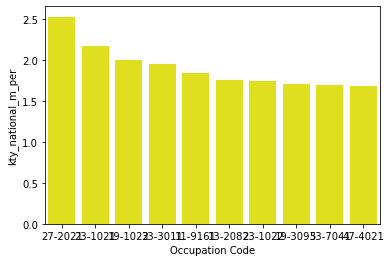

In [31]:
sns.barplot(data=df_sate_National_top, x="Occupation Code", y="kty_national_m_per", color='yellow')

Get the average % 

In [32]:
df_state_National['kty_national_m_per'].mean()*100

111.94423847438628

## SECTION 4

Kentucky is a very large and diverse state. Comparing Kentucky as a whole to National data can be informative, but to fully understand compensation structures, it is better to consider the possibility of regional differences.

Read in regional occupation data in the file called 2021_LWAOccupationalEmploymentAndWages_OneSheet.xlsx (data pulled and compiled from https://kystats.ky.gov/KYLMI/OEWSWage)

In [33]:
df_KY_regional=pd.read_excel('2021_LWAOccupationalEmploymentAndWages_OneSheet.xlsx ')
df_KY_regional

,Region,SOC Code,Standard Occupational Classification (SOC) Title,Estimated Employment,Entry Hourly,Entry Annual,Mean Hourly,Mean Annual,25th Percentile Hourly,25th Percentile Annual,Median Hourly,Median Annual,75th Percentile Hourly,75th Percentile Annual,Experienced Hourly,Experienced Annual
0,Bluegrass,00-0000,Total All Occupations,361680.0,9.99,20778.0,23.16,48172.0,12.97,26982.0,18.89,39299.0,28.32,58918.0,40.09,83376.0
1,Bluegrass,11-0000,Management Occupations,19360.0,20.69,43040.0,47.61,99035.0,28.68,59649.0,40.16,83534.0,58.51,121700.0,84.51,175782.0
2,Bluegrass,11-1011,Chief Executives,640.0,34.64,72044.0,79.49,165334.0,44.68,92945.0,64.65,134482.0,NaN,NaN,NaN,NaN
3,Bluegrass,11-1021,General and Operations Managers,7200.0,17.91,37260.0,46.20,96082.0,26.07,54223.0,35.86,74591.0,56.84,118221.0,91.69,190702.0
4,Bluegrass,11-2011,Advertising and Promotions Managers,20.0,20.69,43050.0,53.89,112110.0,26.05,54186.0,37.82,78671.0,70.81,147288.0,NaN,NaN
5,Bluegrass,11-2021,Marketing Managers,390.0,23.53,48946.0,46.74,97231.0,29.05,60411.0,43.91,91327.0,58.39,121463.0,82.01,170575.0
6,Bluegrass,11-2022,Sales Managers,710.0,27.29,56753.0,56.66,117833.0,32.66,67923.0,50.07,104145.0,73.36,152603.0,98.68,205243.0
7,Bluegrass,11-2030,Public Relations and Fundraising Managers,200.0,27.96,58168.0,54.78,113960.0,38.15,79351.0,50.77,105607.0,69.71,144997.0,85.05,176910.0
8,Bluegrass,11-3010,Administrative Services and Facilities Managers,530.0,21.12,43932.0,40.78,84816.0,26.19,54490.0,36.48,75868.0,52.79,109815.0,66.56,138433.0
9,Bluegrass,11-3031,Financial Managers,1230.0,25.24,52511.0,53.76,111832.0,33.68,70055.0,46.90,97534.0,64.64,134466.0,89.38,185914.0


Merge the State and National dataframe you created in Part 2 with the regional data using SOC code as your merge key. Keep only the data contained in both data set. Make sure the index is the string titles associated with the SOC codes.

In [34]:
df_KY_regional

,Region,SOC Code,Standard Occupational Classification (SOC) Title,Estimated Employment,Entry Hourly,Entry Annual,Mean Hourly,Mean Annual,25th Percentile Hourly,25th Percentile Annual,Median Hourly,Median Annual,75th Percentile Hourly,75th Percentile Annual,Experienced Hourly,Experienced Annual
0,Bluegrass,00-0000,Total All Occupations,361680.0,9.99,20778.0,23.16,48172.0,12.97,26982.0,18.89,39299.0,28.32,58918.0,40.09,83376.0
1,Bluegrass,11-0000,Management Occupations,19360.0,20.69,43040.0,47.61,99035.0,28.68,59649.0,40.16,83534.0,58.51,121700.0,84.51,175782.0
2,Bluegrass,11-1011,Chief Executives,640.0,34.64,72044.0,79.49,165334.0,44.68,92945.0,64.65,134482.0,NaN,NaN,NaN,NaN
3,Bluegrass,11-1021,General and Operations Managers,7200.0,17.91,37260.0,46.20,96082.0,26.07,54223.0,35.86,74591.0,56.84,118221.0,91.69,190702.0
4,Bluegrass,11-2011,Advertising and Promotions Managers,20.0,20.69,43050.0,53.89,112110.0,26.05,54186.0,37.82,78671.0,70.81,147288.0,NaN,NaN
5,Bluegrass,11-2021,Marketing Managers,390.0,23.53,48946.0,46.74,97231.0,29.05,60411.0,43.91,91327.0,58.39,121463.0,82.01,170575.0
6,Bluegrass,11-2022,Sales Managers,710.0,27.29,56753.0,56.66,117833.0,32.66,67923.0,50.07,104145.0,73.36,152603.0,98.68,205243.0
7,Bluegrass,11-2030,Public Relations and Fundraising Managers,200.0,27.96,58168.0,54.78,113960.0,38.15,79351.0,50.77,105607.0,69.71,144997.0,85.05,176910.0
8,Bluegrass,11-3010,Administrative Services and Facilities Managers,530.0,21.12,43932.0,40.78,84816.0,26.19,54490.0,36.48,75868.0,52.79,109815.0,66.56,138433.0
9,Bluegrass,11-3031,Financial Managers,1230.0,25.24,52511.0,53.76,111832.0,33.68,70055.0,46.90,97534.0,64.64,134466.0,89.38,185914.0


In [35]:
#df_KY_regional merge df_state_National

df_new= pd.merge(df_state_National, df_KY_regional, left_on='SOC Code', right_on='SOC Code', how='left')
df_new

,SOC Code,Estimated Employment_x,Entry Hourly_x,Entry Annual_x,Mean Hourly_x,Mean Annual_x,25th Percentile Hourly_x,25th Percentile Annual_x,Median Hourly_x,Median Annual _x,75th Percentile Hourly_x,75th Percentile Annual_x,Experienced Hourly_x,Experienced Annual_x,Unnamed: 15,Occupation Code,Employment 2020,Employment 2030,"Employment Change, 2020-2030","Employment Percent Change, 2020-2030","Occupational Openings, 2020-2030 Annual Average",Median Annual Wage 2020,Typical Entry-Level Education,Education Code,Work Experience in a Related Occupation,Workex Code,Typical on-the-job Training,trCode,kty_national_m_per,Region,Standard Occupational Classification (SOC) Title,Estimated Employment_y,Entry Hourly_y,Entry Annual_y,Mean Hourly_y,Mean Annual_y,25th Percentile Hourly_y,25th Percentile Annual_y,Median Hourly_y,Median Annual _y,75th Percentile Hourly_y,75th Percentile Annual_y,Experienced Hourly_y,Experienced Annual_y
0,00-0000,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Bluegrass,Total All Occupations,361680.0,9.99,20778.0,23.16,48172.0,12.97,26982.0,18.89,39299.0,28.32,58918.0,40.09,83376.0
1,00-0000,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cumberlands,Total All Occupations,105370.0,9.17,19086.0,18.94,39415.0,11.16,23197.0,15.16,31518.0,22.55,46900.0,32.29,67157.0
2,00-0000,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,EKCEP,Total All Occupations,104850.0,8.93,18575.0,19.75,41061.0,10.84,22534.0,15.78,32836.0,23.96,49836.0,32.79,68209.0
3,00-0000,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Green River,Total All Occupations,80000.0,9.62,20009.0,21.20,44106.0,12.44,25871.0,17.48,36357.0,25.55,53153.0,35.69,74240.0
4,00-0000,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Kentuckiana Works,Total All Occupations,510420.0,10.61,22078.0,24.86,51705.0,13.92,28937.0,19.84,41255.0,30.04,62485.0,42.53,88448.0
5,00-0000,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Lincoln Trail,Total All Occupations,85870.0,9.82,20436.0,21.90,45548.0,12.75,26502.0,18.20,37849.0,26.59,55307.0,38.30,79666.0
6,00-0000,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Northern Kentucky,Total All Occupations,204790.0,10.50,21841.0,23.53,48938.0,13.86,28831.0,19.15,39837.0,28.39,59044.0,40.82,84915.0
7,00-0000,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,South Central,Total All Occupations,110610.0,9.52,19800.0,20.69,43024.0,11.90,24760.0,16.79,34930.0,24.89,51757.0,35.60,74056.0
8,00-0000,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TENCO,Total All Occupations,64720.0,9.22,19165.0,20.67,42996.0,11.50,23935.0,16.68,34692.0,25.45,52929.0,36.17,75222.0
9,00-0000,1782580.0,9.86,20515.0,22.69,47208.0,12.80,26611.0,18.37,38208.0,27.48,57163.0,39.45,82060.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,West Kentucky,Total All Occupations,142880.0,9.41,19575.0,21.13,43960.0,12.24,25459.0,17.30,35984.0,25.47,52991.0,36.87,76693.0


Create two new variables by calculating the regional median annual salary percent of kentucky median annual salary AND the regional median annual salary percent of the national median annual salary.

In [36]:
#regional percent of kentucky median salary percent of kentuck00y median
df_new['Regional_per_KY'] = df_new['Median Annual _y']/df_new['Median Annual _x']
df_new['Regional_per_Nat'] = df_new['Median Annual _y']/df_new['Median Annual Wage 2020']


Create a pivot table to determine which region has the most occupations where the average regional percent of national salary is greater the the regional percent of KY salary.


In [37]:
temp = df_new[df_new['Regional_per_Nat']>df_new['Regional_per_KY']]
pvt = temp.pivot_table(index='Region', values='SOC Code', aggfunc='count')

pvt.sort_values(by='SOC Code', ascending = False)


,SOC Code
Region,
Kentuckiana Works,106
Bluegrass,101
Northern Kentucky,86
West Kentucky,74
South Central,68
Green River,66
Lincoln Trail,59
Cumberlands,56
EKCEP,49


## SECTION 5

### USE THE SAME OCCUPATIONS YOU USED IN SECTION 2 TO COMPLETE SECTION 5 

Calculate the regional compensation growth potential for the occupations you used in Section 2. NOTE: YOU MAY RECEIVE AN ERROR IF THERE ARE MISSING DATA; CONTINUE WITH THAT ERROR

In [38]:
df_new_1=df_new[df_new['SOC Code'].str[:2]=='35']
df_new_1

,SOC Code,Estimated Employment_x,Entry Hourly_x,Entry Annual_x,Mean Hourly_x,Mean Annual_x,25th Percentile Hourly_x,25th Percentile Annual_x,Median Hourly_x,Median Annual _x,75th Percentile Hourly_x,75th Percentile Annual_x,Experienced Hourly_x,Experienced Annual_x,Unnamed: 15,Occupation Code,Employment 2020,Employment 2030,"Employment Change, 2020-2030","Employment Percent Change, 2020-2030","Occupational Openings, 2020-2030 Annual Average",Median Annual Wage 2020,Typical Entry-Level Education,Education Code,Work Experience in a Related Occupation,Workex Code,Typical on-the-job Training,trCode,kty_national_m_per,Region,Standard Occupational Classification (SOC) Title,Estimated Employment_y,Entry Hourly_y,Entry Annual_y,Mean Hourly_y,Mean Annual_y,25th Percentile Hourly_y,25th Percentile Annual_y,Median Hourly_y,Median Annual _y,75th Percentile Hourly_y,75th Percentile Annual_y,Experienced Hourly_y,Experienced Annual_y,Regional_per_KY,Regional_per_Nat
2221,35-0000,148160.0,8.41,17486.0,11.54,24012.0,9.07,18864.0,10.28,21370.0,12.70,26415.0,15.95,33190.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Bluegrass,Food Preparation and Serving Related Occupations,31140.0,8.37,17417.0,11.62,24185.0,9.03,18787.0,10.27,21347.0,12.75,26519.0,16.13,33545.0,0.998924,NaN
2222,35-0000,148160.0,8.41,17486.0,11.54,24012.0,9.07,18864.0,10.28,21370.0,12.70,26415.0,15.95,33190.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cumberlands,Food Preparation and Serving Related Occupations,9600.0,8.32,17309.0,10.56,21961.0,8.87,18452.0,9.79,20364.0,11.65,24249.0,13.77,28626.0,0.952925,NaN
2223,35-0000,148160.0,8.41,17486.0,11.54,24012.0,9.07,18864.0,10.28,21370.0,12.70,26415.0,15.95,33190.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,EKCEP,Food Preparation and Serving Related Occupations,9170.0,8.34,17339.0,10.47,21788.0,8.85,18403.0,9.70,20172.0,11.34,23599.0,13.52,28111.0,0.943940,NaN
2224,35-0000,148160.0,8.41,17486.0,11.54,24012.0,9.07,18864.0,10.28,21370.0,12.70,26415.0,15.95,33190.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Green River,Food Preparation and Serving Related Occupations,5900.0,8.40,17472.0,11.24,23368.0,9.03,18791.0,10.14,21093.0,12.28,25537.0,15.23,31679.0,0.987038,NaN
2225,35-0000,148160.0,8.41,17486.0,11.54,24012.0,9.07,18864.0,10.28,21370.0,12.70,26415.0,15.95,33190.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Kentuckiana Works,Food Preparation and Serving Related Occupations,37750.0,8.54,17764.0,12.29,25563.0,9.34,19444.0,11.02,22928.0,13.91,28928.0,17.40,36206.0,1.072906,NaN
2226,35-0000,148160.0,8.41,17486.0,11.54,24012.0,9.07,18864.0,10.28,21370.0,12.70,26415.0,15.95,33190.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Lincoln Trail,Food Preparation and Serving Related Occupations,7570.0,8.41,17502.0,11.06,23008.0,9.12,18959.0,10.37,21576.0,12.23,25440.0,14.84,30886.0,1.009640,NaN
2227,35-0000,148160.0,8.41,17486.0,11.54,24012.0,9.07,18864.0,10.28,21370.0,12.70,26415.0,15.95,33190.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Northern Kentucky,Food Preparation and Serving Related Occupations,16880.0,8.48,17645.0,12.33,25641.0,9.22,19173.0,10.74,22350.0,14.18,29498.0,18.28,38031.0,1.045859,NaN
2228,35-0000,148160.0,8.41,17486.0,11.54,24012.0,9.07,18864.0,10.28,21370.0,12.70,26415.0,15.95,33190.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,South Central,Food Preparation and Serving Related Occupations,8960.0,8.36,17379.0,11.07,23026.0,8.98,18686.0,10.08,20968.0,12.24,25471.0,15.14,31505.0,0.981189,NaN
2229,35-0000,148160.0,8.41,17486.0,11.54,24012.0,9.07,18864.0,10.28,21370.0,12.70,26415.0,15.95,33190.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TENCO,Food Preparation and Serving Related Occupations,7050.0,8.37,17419.0,10.77,22413.0,8.95,18606.0,9.91,20623.0,11.76,24445.0,13.95,29018.0,0.965044,NaN
2230,35-0000,148160.0,8.41,17486.0,11.54,24012.0,9.07,18864.0,10.28,21370.0,12.70,26415.0

Plot a boxplot that shows the range of regional growth potential for each region

<ipython-input-58-5f38773fc6c6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_new_1['G_pot'] = (df_new_1['Experienced Annual_y'] - df_new_1['Entry Annual_y'])/df_new_1['Entry Annual_y']


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15]),
 [Text(0, 0, 'Food Preparation and Serving Related Occupations'),
  Text(1, 0, 'Chefs and Head Cooks'),
  Text(2, 0, 'First-Line Supervisors of Food Preparation and Serving Workers'),
  Text(3, 0, 'Cooks, Fast Food'),
  Text(4, 0, 'Cooks, Institution and Cafeteria'),
  Text(5, 0, 'Cooks, Restaurant'),
  Text(6, 0, 'Cooks, Short Order'),
  Text(7, 0, 'Food Preparation Workers'),
  Text(8, 0, 'Bartenders'),
  Text(9, 0, 'Fast Food and Counter Workers'),
  Text(10, 0, 'Waiters and Waitresses'),
  Text(11, 0, 'Food Servers, Nonrestaurant'),
  Text(12, 0, 'Dining Room and Cafeteria Attendants and Bartender Helpers'),
  Text(13, 0, 'Dishwashers'),
  Text(14, 0, 'Hosts and Hostesses, Restaurant, Lounge, and Coffee Shop'),
  Text(15, 0, 'Food Preparation and Serving Related Workers, All Other')])

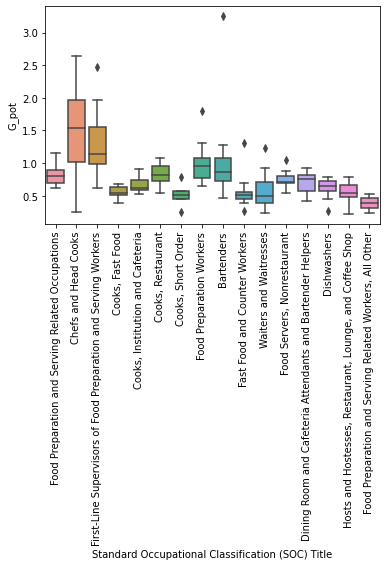

In [58]:
df_new_1['G_pot'] = (df_new_1['Experienced Annual_y'] - df_new_1['Entry Annual_y'])/df_new_1['Entry Annual_y']
sns.boxplot(data=df_new_1, x='Standard Occupational Classification (SOC) Title', y='G_pot')
plt.xticks(rotation=90)

Create a pivot table to show the 4 regions with the highest regional growth potential for your occupation area

In [44]:
df_new_1.pivot_table(index='Region', values='G_pot', aggfunc='mean').sort_values(by='G_pot', ascending=False)

,G_pot
Region,
Northern Kentucky,0.968203
Bluegrass,0.947315
Kentuckiana Works,0.931032
Cumberlands,0.903897
TENCO,0.804601
Green River,0.777546
West Kentucky,0.751480
South Central,0.691834
Lincoln Trail,0.653640


Using the results of the pivot table you just made, create a panel of bar charts displaying the regional growth potential in the top 4 regions by occupation (there should be 4 charts, each with regional grown potential on the y axis and occupation title on the x axis).

In [53]:
top_4 = df_new_1.pivot_table(index='Region', values='G_pot', aggfunc='mean').sort_values(by='G_pot', ascending=False)[0:4].index


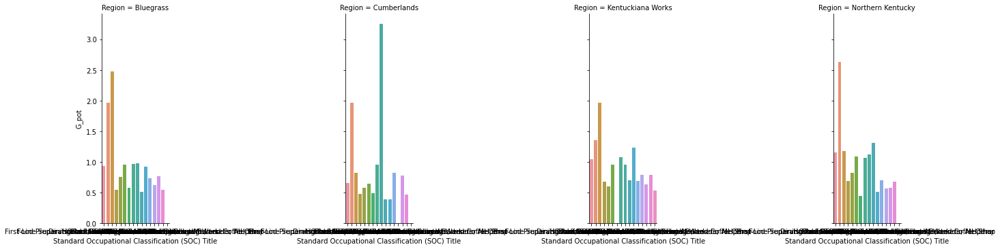

In [60]:
sns.catplot(data=df_new_1[df_new_1['Region'].isin(top_4)], x='Standard Occupational Classification (SOC) Title', y='G_pot', kind='bar', col='Region')


## SECTION 6 

Using the data and figures you generated above, explain at least 3 findings you thought were interesting and at least 1 future direction for data analysis.

The three interestings that I felt were :

1. Section2 , where classification of the occupations as broad and non-broad categories was a game changer for the entire classification , and that is the actual stating point for me /us where data analysis got intitated

2.Section2, percentage growth of occupations with respect to salries, was of interest, as what occupations would see what kind of growth prosepects in the future would give a more benificitial insights, as far as I/we see.

3. Section5, The question is  
'Using the results of the pivot table you just made, create a panel of bar charts displaying the regional growth potential in the top 4 regions by occupation (there should be 4 charts, each with regional grown potential on the y axis and occupation title on the x axis)'. .....answering this would give and insight about the regional occupations at large in the gievn regions and in a way it is the final yield of all the above analysis. 